In [4]:
import json
import pandas as pd
import numpy as np
import os.path
import convertCSV2JSON as c2j
from PhonoSearchLib import LangSearchEngine
from scipy.spatial import Delaunay
from string import capwords
from IPAParser import parseCons, parsePhon

join_by_comma = lambda x: ', '.join(str(el) for el in x)
to_lower = lambda x: x.lower()
map_to_list = lambda x, func: list(map(func, x))

engine = LangSearchEngine('dbase/phono_dbase.json', False)
#' | '.join([el for el in dir(engine) if not el.startswith('_')])
lang_data = pd.read_csv('phoible-aggregated.tsv', sep='\t')

#lang_data.head()

# Some languages do not have coords!
# lang_data[~lang_data['Latitude'].notnull()].head()

phon_data = pd.read_csv('phoible-phonemes.tsv', sep='\t')
eur_lang_codes = [el['code'] for el in engine.lang_dic.values()]
sample = lang_data[lang_data['Area'].isin(['Asia', 'Europe']) &
                   ~lang_data['Country'].isin(['Indonesia', 'Malaysia', 'Brunei']) &
                   ~lang_data['LanguageCode'].isin(eur_lang_codes) &
                   ~lang_data['Source'].isin(['SPA'])]

# sample['LanguageFamilyRoot'].unique()

with open('phoible_groups_to_langs.json', 'r', encoding='utf-8') as inp:
    groups_to_fams = json.load(inp)

# phon_data.head()

sample_codes = sample['LanguageCode'].unique()
sample_names = map_to_list(sample['LanguageName'].unique(), to_lower)

phono_sample = phon_data[(phon_data['LanguageCode'].isin(sample_codes) |
                         phon_data['LanguageName'].apply(to_lower).isin(sample_names)) &
                         ~phon_data['Source'].isin(['SPA']) &
                         phon_data['Class'].isin(['consonant'])]
phono_sample = phono_sample[['LanguageCode', 'LanguageName', 'Phoneme']]

lang_blacklist = set()
for i, p in enumerate(phono_sample['Phoneme']):
    try:
        parsePhon(p)
    except Exception as error:
        lang_blacklist.add(capwords(phono_sample.iloc[i,]['LanguageName'].lower()))
lang_blacklist = list(lang_blacklist)
#lang_blacklist

In [5]:
inventories = phono_sample.groupby('LanguageName').agg(join_by_comma)
inventories['LanguageCode'] = inventories['LanguageCode'].apply(lambda x: x.split(', ')[0])
inventories[inventories.index.name] = pd.Series(inventories.index).apply(capwords)
inventories['LanguageName'] = list(map_to_list(inventories.index, capwords))
inventories = inventories[~inventories['LanguageName'].isin(lang_blacklist)]

inventories['Phylum'] = None
inventories['Genus'] = None
inventories['Latitude'] = None
inventories['Longitude'] = None
# inventories.head()


genera = []
lats   = []
lons   = []
for i, ln in enumerate(inventories['LanguageName']):
    rows = lang_data[~lang_data['Source'].isin(['SPA']) &
                     (lang_data['LanguageName'].apply(capwords) == ln)]
    genus = rows.iloc[0,]['LanguageFamilyGenus'].strip()
    inventories['Genus'][i] = genus
    phylum = groups_to_fams[genus]
    inventories['Phylum'][i] = phylum
    try:
        lat = float(rows.iloc[0,]['Latitude'].replace(':', '.'))
        inventories['Latitude'][i] = lat
    except:
        continue
    try:
        lon = float(rows.iloc[0,]['Longitude'].replace(':', '.'))
        inventories['Longitude'][i] = lon
    except:
        continue

inventories['Timestamp'] = None
# LanguageName
# LanguageCode
# Latitude
# Longitude
inventories['Lang_or_dial'] = "Язык"
# Phylum
# Genus
inventories['Source'] = "PHOIBLE"
inventories['Source_short'] = None
# Phoneme
inventories['Vowels'] = None
inventories['Tones'] = None
inventories['Syllables'] = None
inventories['Initial_clusters'] = None
inventories['Finals'] = None
inventories['Comments'] = None
inventories['Added_by'] = "PHOIBLE"

new_col_list = ['Timestamp',
                'LanguageName',
                'LanguageCode',
                'Latitude',
                'Longitude',
                'Lang_or_dial',
                'Phylum',
                'Genus',
                'Source',
                'Source_short',
                'Phoneme',
                'Vowels',
                'Tones',
                'Syllables',
                'Initial_clusters',
                'Finals',
                'Comments',
                'Added_by'
               ]

inventories = inventories[new_col_list]

with open('dbase/ffli-dbase.csv', 'r', encoding='utf-8') as inp:
    with open('all_data.csv', 'w', encoding='utf-8') as out:
        out.write(inp.read() + '\n')
        for i in range(inventories.shape[0]):
            out.write('\t'.join(str(el) for el in inventories.iloc[i,]) + '\n')

with open ('all_data.json', 'w', encoding='utf-8') as out:
    json.dump(c2j.convert2JSON("all_data.csv"), out, indent=4, ensure_ascii=False)

big_engine = LangSearchEngine('all_data.json', False)

names = []
lats  = []
lons  = []
phyla = []
for key, val in big_engine.coord_dic.items():
    if key.startswith('Naukan') or key.startswith('Chukchi'): continue
    names.append(key.split('#')[0])
    lat, lon = val
    lats.append(lat)
    lons.append(lon)
    if lat == "None" or lon == "None":
        print(key)
    phyla.append(big_engine.lang_dic[key]['gen'][0])
coords_table = pd.DataFrame({'LangName': names, 'Latitude': lats, 'Longitude': lons, 'Phylum': phyla})
coords_table.to_csv('all_data_coords.csv', index=False)

In [6]:
points = np.column_stack((lons,lats))
lang_tri = Delaunay(points, qhull_options=['QJ'])

indices, indptr = lang_tri.vertex_neighbor_vertices

In [7]:
q = names.index('Kusunda')
print(q, names[q], lats[q], lons[q])
print()
for i in indptr[indices[q]:indices[q+1]]:
    print(names[i])

227 Kusunda 28.0 84.4

Gurung (Western)
Bhujel
Nepali
Nar-Phu (Nar)
Manange


In [8]:
%matplotlib inline
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap

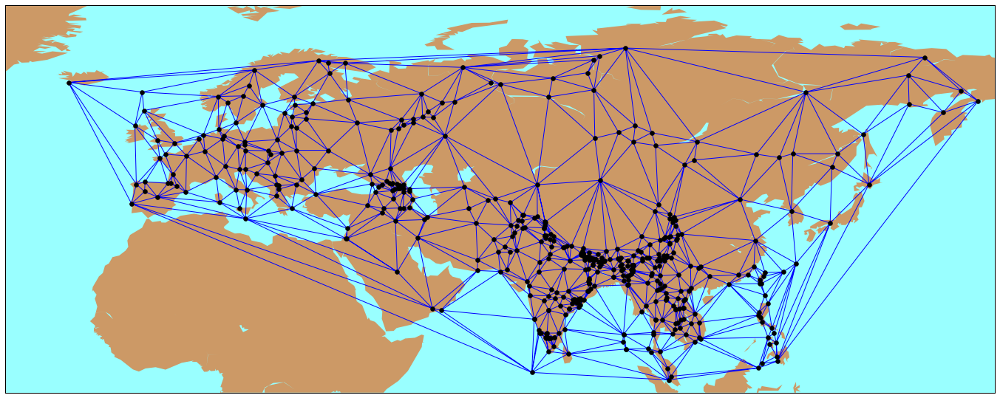

In [9]:
m = Basemap(llcrnrlon=-35.0, llcrnrlat=0, urcrnrlon=169, urcrnrlat=80)
x, y = m(
    list(map(float,lons)),
    list(map(float,lats))
)
plt.figure(figsize=(24,15))
m.drawmapboundary(fill_color='#99ffff')
m.fillcontinents(color='#cc9966',lake_color='#99ffff')
m.plot(x,y,'ko',markersize=6)
# for label, xpt, ypt in zip(names, x, y):
#     plt.text(xpt, ypt, label)
plt.triplot(x, y, lang_tri.simplices.copy())

In [11]:
from geopy.distance import VincentyDistance

# 1000 km were chosen as the cut-off point
# print(', '.join("%.0f" % el for el in [np.percentile(distances, i) for i in range(10, 100, 2)]))

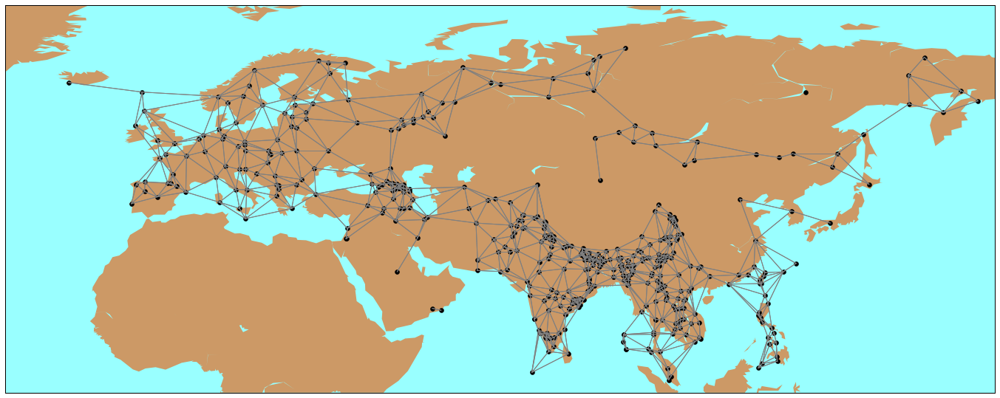

In [12]:
x, y = m(
    list(map(float,lons)),
    list(map(float,lats))
)
plt.figure(figsize=(24,15))
m.drawmapboundary(fill_color='#99ffff')
m.fillcontinents(color='#cc9966',lake_color='#99ffff')
m.plot(x,y,'ko',markersize=6)
distances = []
for i in range(len(names)):   #(len(names)):
    lon1, lat1 = lons[i], lats[i]
    for el in indptr[indices[i]:indices[i+1]]:
        lon2,lat2 = lons[el], lats[el]
        d = VincentyDistance((lat1, lons[i]), (lats[el], lons[el])).kilometers
        if d < 1000:
            plt.plot(
                [x[i], x[el]],
                [y[i], y[el]],
                '-', lw=1,
                color = 'grey'
            )
        distances.append(d)

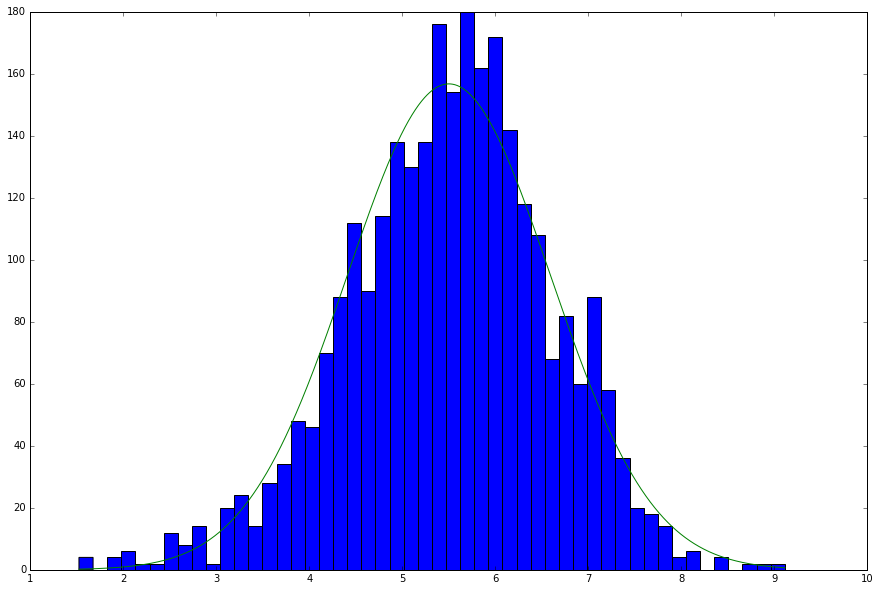

In [13]:
distances = np.array(distances)
distances = np.log(distances)

# Pairwise distances between Eurasian langs are log-normal. Who'd've thought.
import matplotlib.mlab as mlab
plt.figure(figsize=(15,10))
n, bins, patches = plt.hist(distances, 50)
sigma = np.std(distances)
mu = np.mean(distances)
x = np.linspace(min(bins), max(bins), 10000)
# np.min(np.diff(bins)) is the width of the bin to up-scale the normal distribution
plt.plot(x,mlab.normpdf(x, mu, sigma)*np.min(np.diff(bins))*len(distances))

In [14]:
# Graph analysis
import networkx as nx
lang_graph = nx.Graph()

for i in range(len(names)):   #(len(names)):
    lon1, lat1 = lons[i], lats[i]
    for el in indptr[indices[i]:indices[i+1]]:
        lon2,lat2 = lons[el], lats[el]
        d = VincentyDistance((lat1, lons[i]), (lats[el], lons[el])).kilometers
        if d < 1000:
#             print([x[i], x[el]], [y[i], y[el]])
            lang_graph.add_edge(i, el)

In [15]:
shortest_paths_dicts = {}
for n in lang_graph.nodes():
    shortest_paths_dicts[n] = nx.single_source_shortest_path_length(lang_graph, n)

In [16]:
names_dict = { name : i for i, name in enumerate(names) }
# names_dict

In [17]:
place_names  = ['bilabial', 'labial-velar', 'labial-palatal', 'labiodental', 'interdental', 'alveolar',
                'postalveolar', 'hissing-hushing', 'retroflex', 'alveolo-palatal', 'palatal', 'palatal-velar',
                'velar', 'uvular', 'pharyngeal', 'glottal', 'epiglottal']
manner_names = ['plosive', 'implosive', 'nasal', 'trill', 'tap', 'lateral_tap', 'fricative',
                'lateral_fricative', 'approximant', 'lateral_approximant']
voice        = ['voiceless', 'voiced']
vot          = ['aspirated', 'glottalised'] # wrong label, replace?
add_art      = ['palatalised', 'labialised']

In [18]:
# Enumerating interesting feature combinations
combs = []
for p in place_names:
    if p == 'glottal':
        for m in ['plosive', 'fricative']:
            if m == 'plosive': combs.append(' '.join([p, m]))
            else:
                for v in voice:
                    combs.append(' '.join([p, m, v]))
    else:
        for m in manner_names:
            for v in voice:
                query_string = ' '.join([p, m, v])
                if list(big_engine.features_query(query_string)):
                    combs.append(query_string)
                for a in add_art:
                    query_string = ' '.join([p, m, v, a])
                    if list(big_engine.features_query(query_string)):
                        combs.append(query_string)
                for vt in vot:
                    query_string = ' '.join([p, m, v, vt])
                    if list(big_engine.features_query(query_string)):
                            combs.append(query_string)
                for a in add_art:
                    for vt in vot:
                        query_string = ' '.join([p, m, v, vt, a])
                        if list(big_engine.features_query(query_string)):
                            combs.append(query_string)         

In [23]:
def exponential_density(accum, dist, k):
    return accum + 1.0/(k**dist)
exp_dens_base_2 = lambda accum, dist: exponential_density(accum, dist, 2)

In [24]:
# Now we compute a density distribution for a given comb in the neighbour graph.
def compute_density_distribution(lang_graph, points_list, accumulator_fun):
    distr_dict = {}
    for node in lang_graph.nodes():
        statistic = 0
        for p in points_list:
            if p not in lang_graph: continue
            if node != p:
                try:
                    dist = nx.shortest_path_length(lang_graph, node, p)
                    statistic = accumulator_fun(statistic, dist)
                except nx.NetworkXNoPath:
                    continue
        distr_dict[node] = statistic
    return distr_dict

In [ ]:
# Tried to shoot meself in the leg
# distribution_dict = {}
# for c in combs:
#     lang_list = big_engine.features_query(c)
#     temp = []
#     for el in lang_list:
#         if not (el.startswith('Chukchi') or el.startswith('Naukan Yupik')):
#                 temp.append(el)
#     lang_list = temp
#     points_list = [ names_dict[l.split('#')[0]] for l in lang_list ]
#     distribution_dict[c] = compute_density_distribution(lang_graph, points_list, exp_dens_base_2)

In [108]:
combs

['bilabial plosive voiceless',
 'bilabial plosive voiceless palatalised',
 'bilabial plosive voiceless labialised',
 'bilabial plosive voiceless aspirated',
 'bilabial plosive voiceless glottalised',
 'bilabial plosive voiceless aspirated palatalised',
 'bilabial plosive voiceless glottalised palatalised',
 'bilabial plosive voiceless aspirated labialised',
 'bilabial plosive voiceless glottalised labialised',
 'bilabial plosive voiced',
 'bilabial plosive voiced palatalised',
 'bilabial plosive voiced labialised',
 'bilabial plosive voiced aspirated',
 'bilabial implosive voiced',
 'bilabial nasal voiceless',
 'bilabial nasal voiceless palatalised',
 'bilabial nasal voiced',
 'bilabial nasal voiced palatalised',
 'bilabial nasal voiced labialised',
 'bilabial nasal voiced aspirated',
 'bilabial fricative voiceless',
 'bilabial fricative voiced',
 'bilabial fricative voiced palatalised',
 'labial-velar approximant voiceless',
 'labial-velar approximant voiced',
 'labial-velar approxima

In [1]:
LANG_BLACKLIST = ['Chukchi', 'Naukan Yupik']
def get_point_list(query_string, search_engine, points_dict, lang_blacklist):
    lang_list = big_engine.features_query(query_string)
    temp = []
    for el in lang_list:
        drop = False
        for stoplang in lang_blacklist:
            if el.startswith(stoplang):
                drop = True
                break
        if drop:
            continue
        else:
            temp.append(el)
    return [ names_dict[l.split('#')[0]] for l in temp ]

In [25]:
dd_voiceless_nasal = compute_density_distribution(lang_graph,
                                                  get_point_list('voiceless nasal',
                                                                 big_engine,
                                                                 names_dict,
                                                                 LANG_BLACKLIST),
                                                  exp_dens_base_2)

In [52]:
sizes

[3.2016842365264893,
 16.39748740196228,
 3.0003971855621785,
 3.127767562866211,
 3.086751937866211,
 11.67336630821228,
 11.49028730392456,
 5.461014546453953,
 8.013428583741188,
 6.29298198223114,
 15.16699880361557,
 3.2368698120117188,
 5.765992037951946,
 15.68848979473114,
 8.027370929718018,
 4.355009078979492,
 3.2133586406707764,
 6.187802642583847,
 5.461014546453953,
 4.186981201171875,
 3.097752571105957,
 3.203359007835388,
 3.147136688232422,
 3.0003971855621785,
 7.060970306396484,
 5.304199632257223,
 3.623199462890625,
 6.234452046453953,
 3.053807258605957,
 4.382996018975973,
 8.566419839859009,
 5.373481750488281,
 15.52442067861557,
 3.623199462890625,
 3.203359007835388,
 3.543877601623535,
 3.0127099379897118,
 6.509871482849121,
 4.230622842907906,
 7.899904042482376,
 6.310652732849121,
 3.0592174530029297,
 3.3170226216316223,
 14.97072958946228,
 7.916227340698242,
 3.0001985927810892,
 3.844960570335388,
 12.53028005361557,
 4.24639892578125,
 6.6013192087

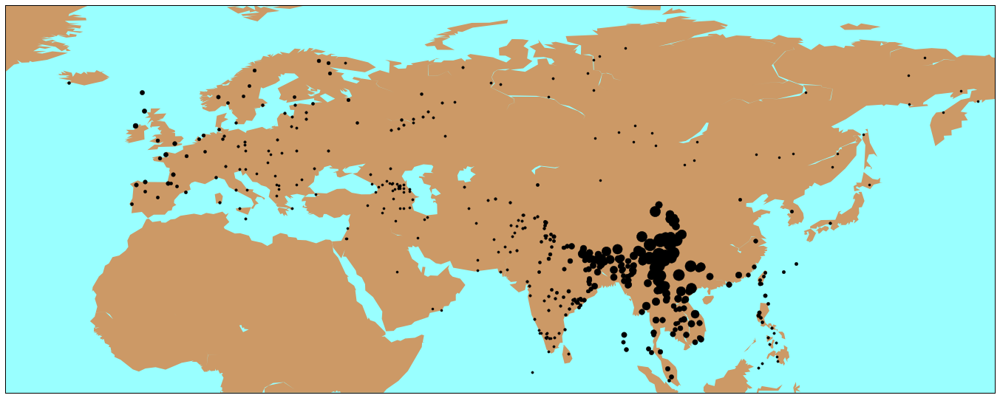

In [63]:
sizes = []
for i in range(len(names)):
    if i in dd_voiceless_nasal:
        sizes.append(dd_voiceless_nasal[i] + 1)
    else:
        sizes.append(1)
sizes = [el * 3 for el in sizes]

m = Basemap(llcrnrlon=-35.0, llcrnrlat=0, urcrnrlon=169, urcrnrlat=80)
x, y = m(
    list(map(float,lons)),
    list(map(float,lats))
)
plt.figure(figsize=(24,15))
m.drawmapboundary(fill_color='#99ffff')
m.fillcontinents(color='#cc9966',lake_color='#99ffff')
for i in range(len(names)):
    m.plot(x[i:i+1],y[i:i+1],'ko',markersize=sizes[i])

In [66]:
def plot_density_map(feature):
    densities = compute_density_distribution(lang_graph,
                                             get_point_list(feature,
                                                            big_engine,
                                                            names_dict,
                                                            LANG_BLACKLIST),
                                             exp_dens_base_2)
    sizes = []
    for i in range(len(names)):
        if i in densities:
            sizes.append(densities[i] + 1)
        else:
            sizes.append(1)
    sizes = [el * 3 for el in sizes]
    m = Basemap(llcrnrlon=-35.0, llcrnrlat=0, urcrnrlon=169, urcrnrlat=80)
    x, y = m(
        list(map(float,lons)),
        list(map(float,lats))
    )
    plt.figure(figsize=(24,15))
    m.drawmapboundary(fill_color='#99ffff')
    m.fillcontinents(color='#cc9966',lake_color='#99ffff')
    for i in range(len(names)):
        m.plot(x[i:i+1],y[i:i+1],'ko',markersize=sizes[i])

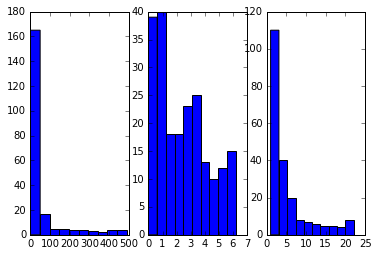

In [89]:
combs_counts = []
for c in combs:
    combs_counts.append(len(big_engine.features_query(c)))
plt.subplot(131)
_ = plt.hist(combs_counts)
plt.subplot(132)
_ = plt.hist(np.log(combs_counts))
plt.subplot(133)
_ = plt.hist(np.sqrt(combs_counts))

In [102]:
combs_of_interest = []
for c in combs:
    count = len(big_engine.features_query(c))
    if count >= 50 and count < len(names)/4:
        combs_of_interest.append(c)
print(len(combs_of_interest))
combs_of_interest

19


['alveolar tap voiced',
 'alveolar approximant voiceless',
 'alveolar lateral_approximant voiceless',
 'postalveolar fricative voiced',
 'retroflex plosive voiceless aspirated',
 'retroflex nasal voiced',
 'retroflex tap voiced',
 'retroflex fricative voiceless',
 'retroflex fricative voiced',
 'retroflex approximant voiced',
 'alveolo-palatal fricative voiceless',
 'palatal plosive voiceless aspirated',
 'palatal plosive voiced',
 'palatal fricative voiceless',
 'velar plosive voiced aspirated',
 'velar fricative voiced',
 'uvular plosive voiceless',
 'uvular fricative voiceless',
 'uvular fricative voiced']

bilabial plosive voiceless
bilabial plosive voiceless palatalised
bilabial plosive voiceless labialised
bilabial plosive voiceless aspirated
bilabial plosive voiceless glottalised
bilabial plosive voiceless aspirated palatalised
bilabial plosive voiceless glottalised palatalised
bilabial plosive voiceless aspirated labialised
bilabial plosive voiceless glottalised labialised
bilabial plosive voiced
bilabial plosive voiced palatalised
bilabial plosive voiced labialised
bilabial plosive voiced aspirated
bilabial implosive voiced
bilabial nasal voiceless
bilabial nasal voiceless palatalised
bilabial nasal voiced
bilabial nasal voiced palatalised
bilabial nasal voiced labialised
bilabial nasal voiced aspirated
bilabial fricative voiceless
bilabial fricative voiced
bilabial fricative voiced palatalised
labial-velar approximant voiceless
labial-velar approximant voiced
labial-velar approximant voiced palatalised
labial-velar approximant voiced aspirated
labial-palatal approximant voiceless
l

/Users/macbook/miniconda2/envs/py35/lib/python3.5/site-packages/matplotlib/pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


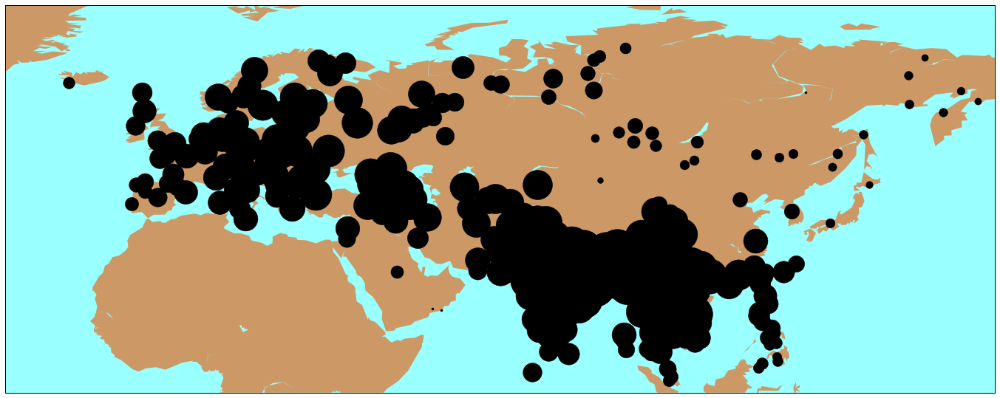

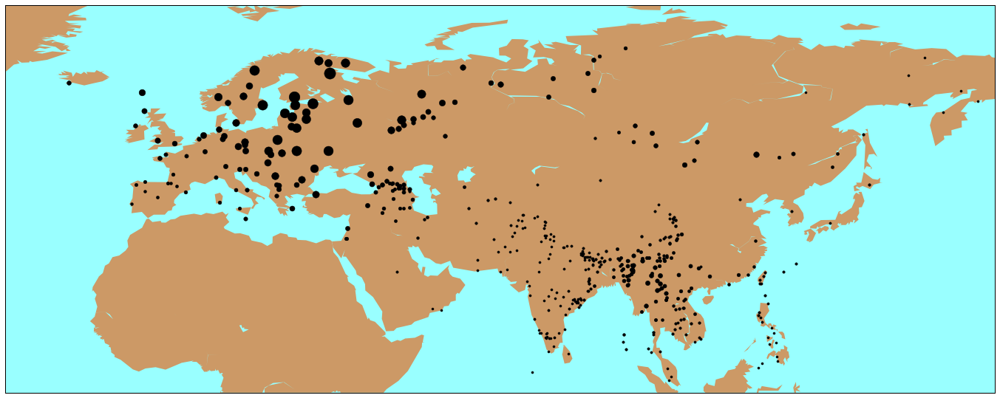

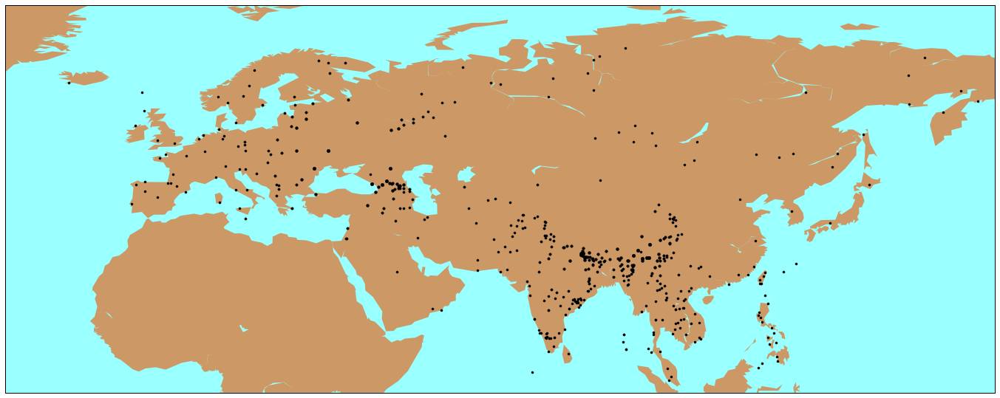

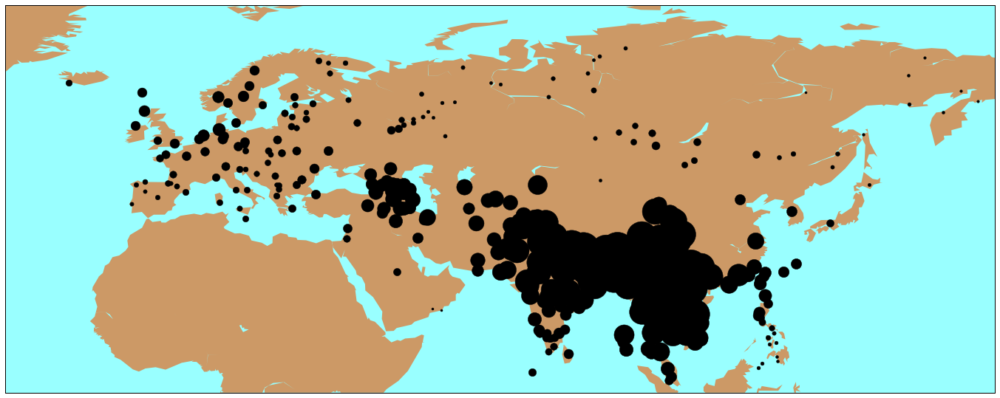

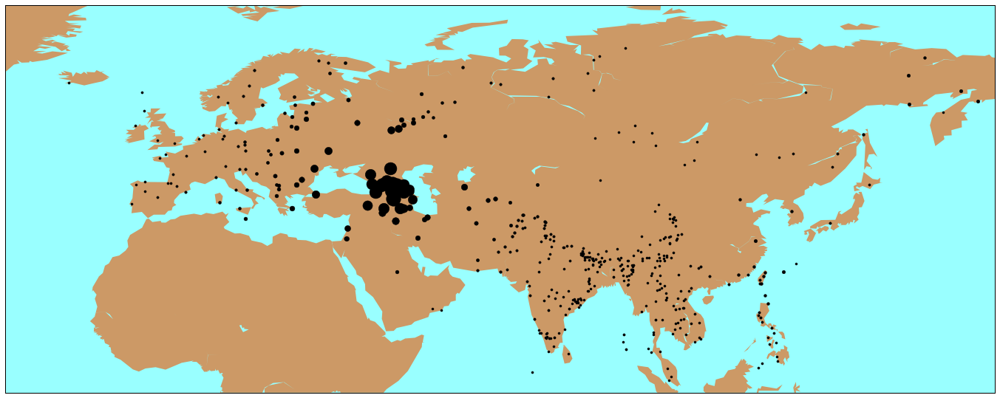

...

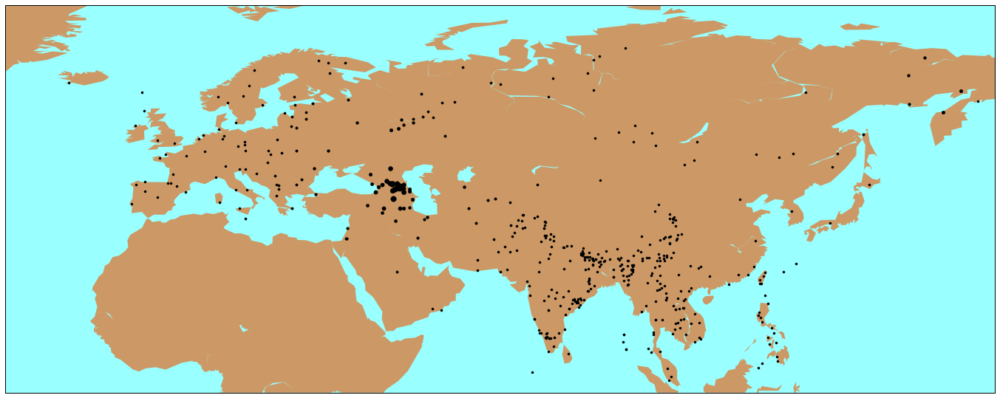

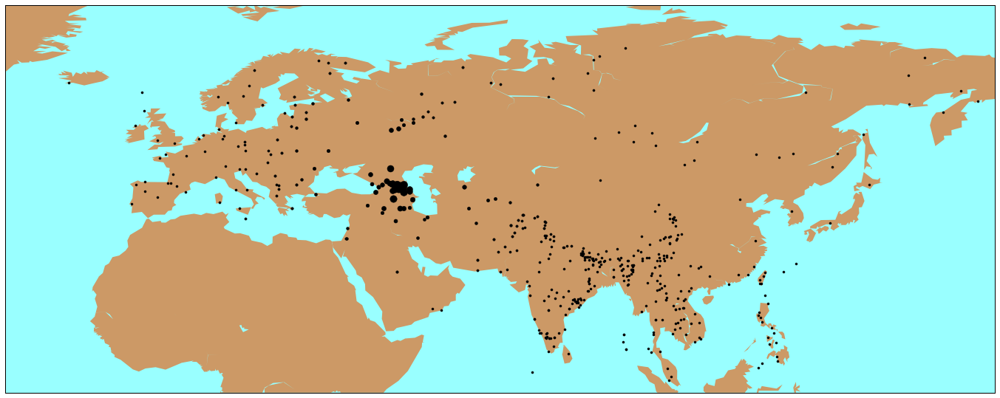

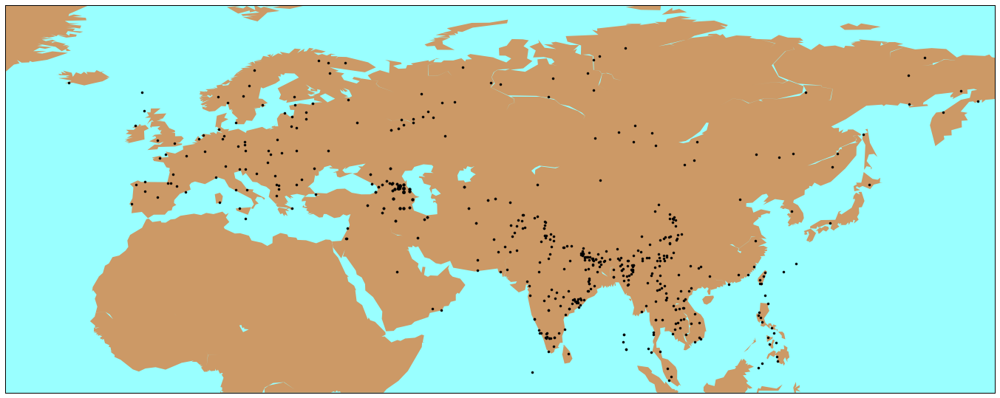

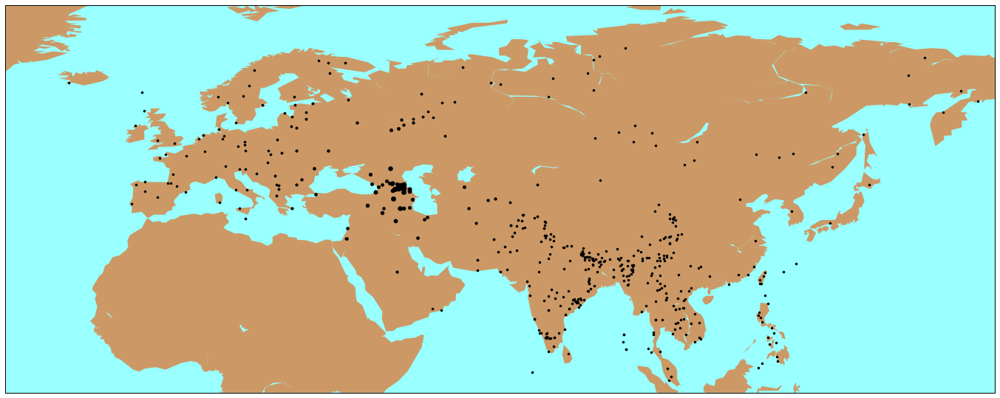

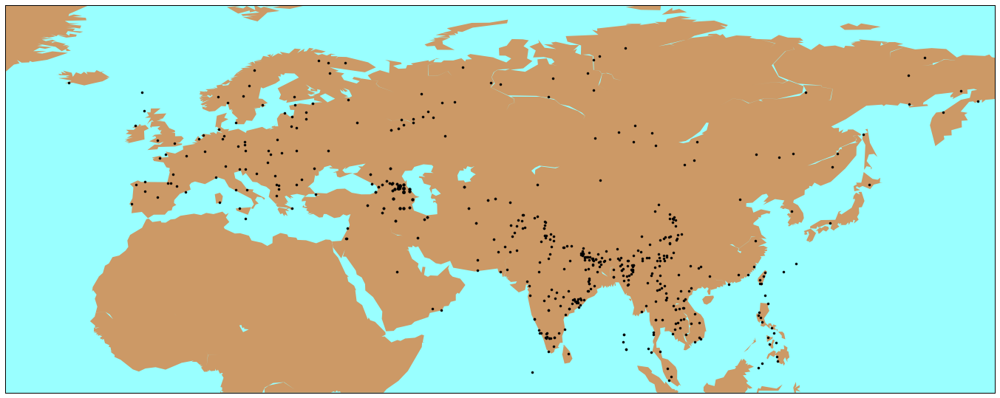

In [109]:
for c in combs:
    print(c)
    plot_density_map(c)
    plt.savefig('plots/%s.png' % c.replace(' ', '_'), bbox_inches='tight')